In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import os
import sys
import random

import numpy as np
import cv2
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
import h5py
import scipy
from keras import backend as K

## Seeding 
seed = 2019
random.seed = seed
np.random.seed = seed
tf.seed = seed





In [ ]:
class DataGen(keras.utils.Sequence):
    def __init__(self, images_path, masks_path, batch_size=8, image_size=128):
        self.batch_size = batch_size
        self.image_size = image_size
        
        
        h5f = h5py.File(images_path,'r')
        images = h5f['all_data'][:]
        h5f.close()



        h5f = h5py.File(masks_path,'r')
        masks = h5f['all_data'][:]
        h5f.close()

        print("bru: ",np.max(masks))

        self.data_size = images.shape[0]
        

        channeled_images = []
        channeled_masks = []
        
        for image in images:
            channeled_images.append(np.stack([image], axis = 3))


        for mask in masks:
            channeled_masks.append(np.stack([mask], axis = 3))
            
        new_indexes = []
        for i in range(0,len(images)):
            index = random.randint(0,len(images)-1)
            while index in new_indexes:
                index = random.randint(0,len(images)-1)
            new_indexes.append(index)


        new_images = []
        new_masks = []
        for index in new_indexes:
            print(index)
            new_images.append(channeled_images[index])
            new_masks.append(channeled_masks[index])
        
        
        
        self.images = np.array(new_images)
        self.masks = np.array(new_masks)

        print("images shape:", self.images.shape)
        print("images max and min:", np.max(images),np.min(images))
        print("masks shape:", self.masks.shape)
        print("masks max and min:", np.max(masks),np.min(masks))

        self.on_epoch_end()
        
        
     
    def __getitem__(self, index):
        BUFFER_SIZE = 1000
        if(index+1)*self.batch_size > self.images.shape[0]:
            self.batch_size = self.images.shape[0] - index*self.batch_size
        
        images = []
        masks  = []

        for image in self.images[index*self.batch_size : (index+1)*self.batch_size]:
            images.append(image)
        for mask in self.masks[index*self.batch_size : (index+1)*self.batch_size]:
            masks.append(mask)
            


        

        images = np.array(images)
        masks  = np.array(masks)
        return images, masks

    def get_array(self, index):
        return np.stack([self.images[index]]), np.stack([self.masks[index]])


    def on_epoch_end(self):
        pass
    
    def __len__(self):
        return int(np.ceil(self.data_size/float(self.batch_size)))

def weighted_mse_frequencies(y_true,y_pred):
    #         [0,    0.1,  0.2,  0.3,   0.4, 0.5,  0.6,  0.7]
    weights = [0.5, 0.03, 0.05, 0.09, 0.14, 0.18, 0.083, 0.083]
    y_true *= 10
    y_pred *= 10
    difference = y_true-y_pred
    squared_error = difference**2
    #print(tf.math.count_nonzero(squared_error))
    everything = tf.cast(tf.cast(y_true != -1,dtype=tf.int32),dtype=tf.float32)
    total_size = K.sum(everything)

    if total_size == 1048576:
        print("correct")
    for n,weight in enumerate(weights):
        binary = tf.cast(tf.cast(y_true == (n),dtype=tf.int32),dtype=tf.float32)
        count = K.sum(binary)
        current_fraction = count/total_size
        if current_fraction > 0:
            weights[n] = weight/current_fraction 
    print(weights)
    total_count = 0.
    for i in range(0,len(weights)):
        binary = tf.cast(tf.cast(y_true == (i),dtype=tf.int32),dtype=tf.float32)
        count = K.sum(binary)*weights[i]
        print(count)
        current_error = binary*squared_error*weights[i]
        total_count += count
        try:
            total_squared_error+=current_error
        except:
            print(i)
            total_squared_error = tf.identity(current_error)
    

    mse = K.sum(total_squared_error)/tf.cast(total_count,dtype=tf.float32)
    return mse*10

smooth=1e-7

def dice_coef(y_true, y_pred):
    actual_true = tf.cast(tf.cast(y_pred > 0.5,dtype=tf.int32),dtype=tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return 1 - ((2. * intersection + 1) / (K.sum(y_true_f) + K.sum(y_pred_f) + 1))

def weighted_bce(y_true, y_pred):    
    actual_true = tf.cast(tf.cast(y_true == 1,dtype=tf.int32),dtype=tf.float32)
    bce = K.binary_crossentropy(actual_true, y_pred)

    everything = tf.cast(tf.cast(y_true != -1,dtype=tf.int32),dtype=tf.float32)
    total_size = K.sum(everything)

    zeros = tf.cast(tf.cast(y_true == 0,dtype=tf.int32),dtype=tf.float32)
    zeros_count = K.sum(zeros)
    current_fraction = zeros_count/total_size
    zero_weight = 0.33/current_fraction 
    print("zero weight:", zero_weight)
    weighted_zeros = zeros * zero_weight

    ones = tf.cast(tf.cast(y_true == 1,dtype=tf.int32),dtype=tf.float32)
    ones_count = K.sum(ones)
    current_fraction = ones_count/total_size
    ones_weight = 0.33/current_fraction 
    print("ones weight:", ones_weight) 
    weighted_ones = ones * ones_weight

    twos = tf.cast(tf.cast(y_true == 2,dtype=tf.int32),dtype=tf.float32)
    twos_count = K.sum(twos)
    current_fraction = twos_count/total_size
    twos_weight = 0.33/current_fraction
    print("twos weight:", twos_weight)
    weighted_twos = twos * twos_weight

    total_weights = weighted_zeros + weighted_ones + weighted_twos

    weighted_bce = K.mean(bce * total_weights)
    return weighted_bce


In [ ]:

def down_block(x, filters, dropout, kernel_size=(3, 3, 3), padding="same", strides=1):
    print(x.shape)
    c = keras.layers.Conv3D(filters, kernel_size, padding=padding, strides=strides, activation="relu", input_shape = x.shape[1:], kernel_initializer='he_normal')(x)
    c = keras.layers.Dropout(dropout)(c)
    c = keras.layers.Conv3D(filters, kernel_size, padding=padding, strides=strides, activation="relu", input_shape = c.shape[1:], kernel_initializer='he_normal')(c)
    p = keras.layers.MaxPool3D(pool_size = (2, 2, 2))(c)
    return c, p

def up_block(x, skip, filters, dropout,kernel_size=(3, 3, 3), padding="same", strides=1):
    us = keras.layers.UpSampling3D((2, 2, 2))(x)
    concat = keras.layers.Concatenate()([us, skip])
    c = keras.layers.Conv3D(filters, kernel_size, padding=padding, strides=strides, activation="relu", input_shape = concat.shape[1:], kernel_initializer='he_normal')(concat)
    c = keras.layers.Dropout(dropout)(c)
    c = keras.layers.Conv3D(filters, kernel_size, padding=padding, strides=strides, activation="relu", input_shape = c.shape[1:], kernel_initializer='he_normal')(c)
    return c

def bottleneck(x, filters, dropout, kernel_size=(3, 3, 3), padding="same", strides=1):
    c = keras.layers.Conv3D(filters, kernel_size, padding=padding, strides=strides, activation="relu", input_shape = x.shape[1:], kernel_initializer='he_normal')(x)
    c = keras.layers.Dropout(dropout) (c)
    c = keras.layers.Conv3D(filters, kernel_size, padding=padding, strides=strides, activation="relu", input_shape = c.shape[1:], kernel_initializer='he_normal')(c)
    return c

def ConvNet(x,y,z):
    inputs = keras.layers.Input((x,y,z, 1))
    
    p0 = inputs
    c1, p1 = down_block(p0, 16, 0.1) #128 -> 64
    print(p1.shape)
    c2, p2 = down_block(p1, 32, 0.1) #64 -> 32
    c3, p3 = down_block(p2, 64, 0.2) #32 -> 16
    c4, p4 = down_block(p3, 128, 0.2) #32 -> 16
    
    bn = bottleneck(p4, 256, 0.4)
    print(bn.shape)
    
    u1 = up_block(bn, c4, 128, 0.3) #8 -> 16
    u2 = up_block(u1, c3, 64, 0.2) #16 -> 32
    u3 = up_block(u2, c2, 32, 0.1) #32 -> 64
    u4 = up_block(u3, c1, 16, 0.1) #32 -> 64
    
    outputs = tf.keras.layers.Conv3D(1, (1, 1, 1),padding='same', activation="sigmoid")(u4)
    #outputs = keras.layers.Conv3D(1, (1, 1, 1), padding="same", activation="relu")(u4)
    print("out")
    print(outputs.shape)
    model = keras.models.Model(inputs, outputs)
    return model


(None, 128, 128, 128, 1)
(None, 64, 64, 64, 16)
(None, 64, 64, 64, 16)
(None, 32, 32, 32, 32)
(None, 16, 16, 16, 64)
(None, 8, 8, 8, 256)
out
(None, 128, 128, 128, 1)
bru:  2.0
17
19
13
15
6
11
20
14
16
1
10
4
3
8
21
12
0
9
5
7
2
18
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
4
2
0
3
1
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
3
4
1
0
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 11 out of 1000 sets...
Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/100
zero weight: Tensor("weighted_bce/truediv_1:0", shape=(), dtype=float32)
ones weight: Tensor("weighted_bce/truediv_3:0", shape=(), dtype=float32)
twos weight: Tensor("weighted_bc

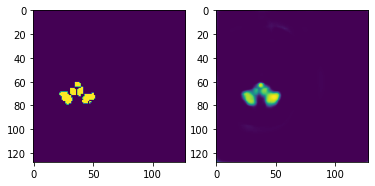

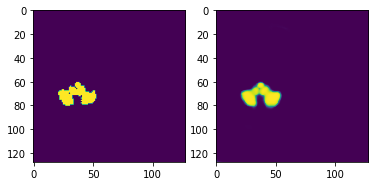

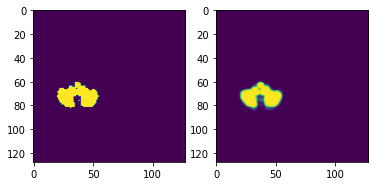

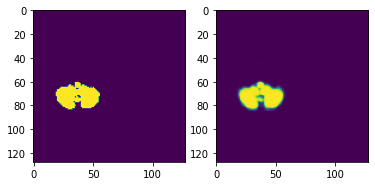

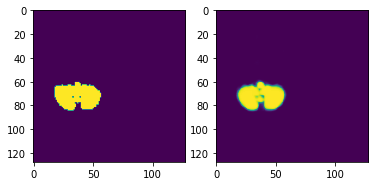

...

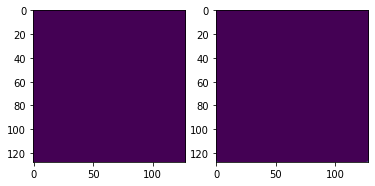

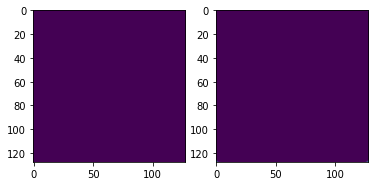

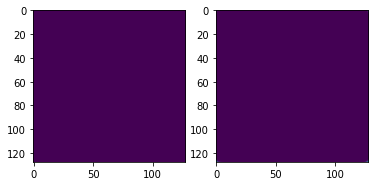

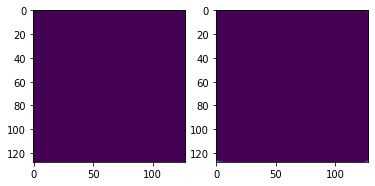

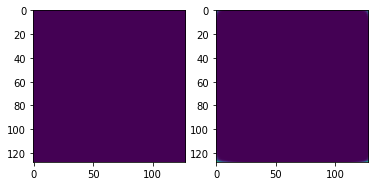

bru:  2.0
21
20
14
10
18
12
2
17
3
11
6
19
4
5
7
0
15
1
13
16
9
8
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
4
1
3
0
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
1
3
0
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 12 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.1315 - acc: 0.9571 - val_loss: 0.1251 - val_acc: 0.9564
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.1344 - acc: 0.9535 - val_loss: 0.1294 - val_acc: 0.9602
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.1153 - acc: 0.9584 - val_loss: 0.1267 - val_acc: 0.9626
Epoch 4/100
22/22 [==============

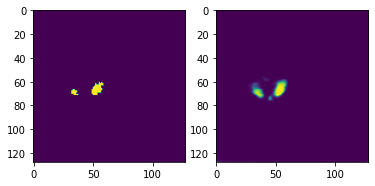

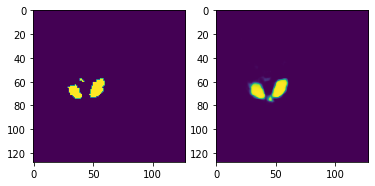

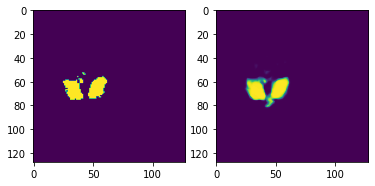

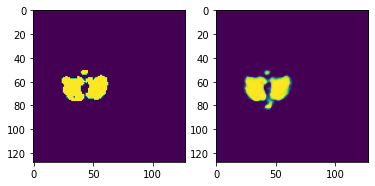

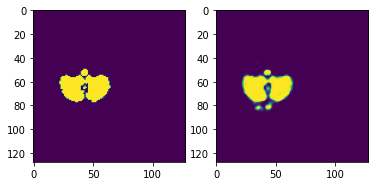

...

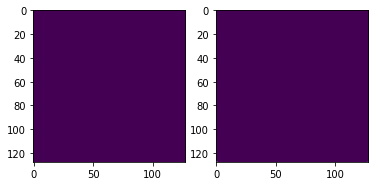

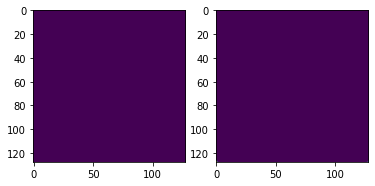

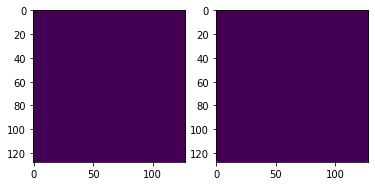

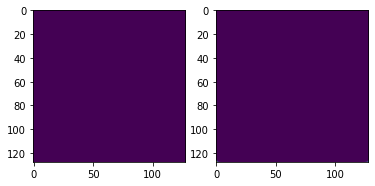

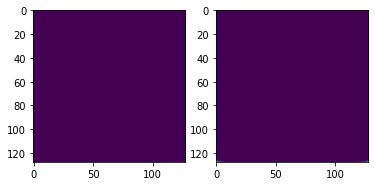

bru:  2.0
7
8
16
21
12
14
2
4
6
13
5
11
1
10
15
0
19
18
3
20
9
17
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
0
1
2
4
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
1
3
0
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 21 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0700 - acc: 0.9624 - val_loss: 0.0785 - val_acc: 0.9619
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0661 - acc: 0.9626 - val_loss: 0.0831 - val_acc: 0.9644
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0624 - acc: 0.9626 - val_loss: 0.0701 - val_acc: 0.9638
Epoch 4/100
22/22 [============

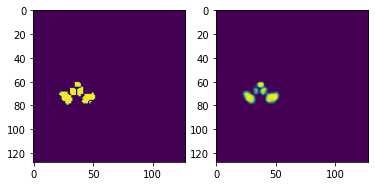

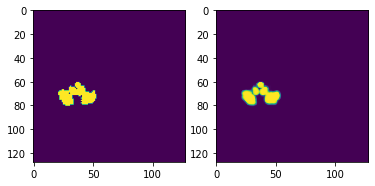

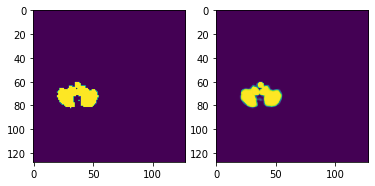

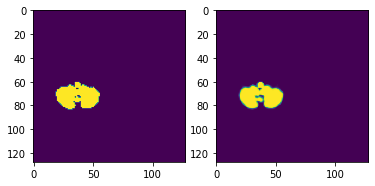

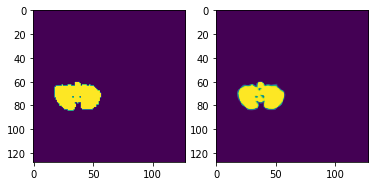

...

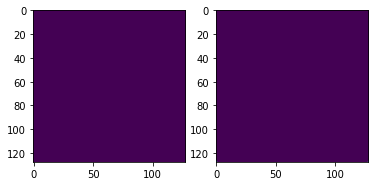

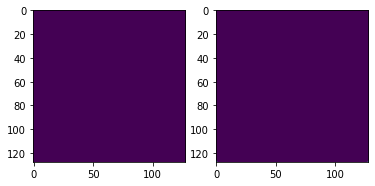

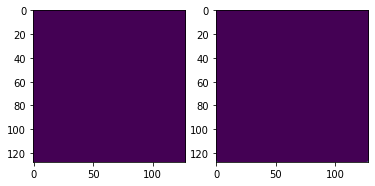

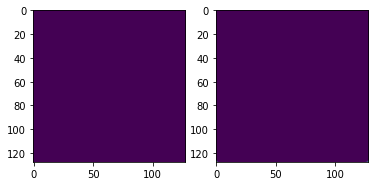

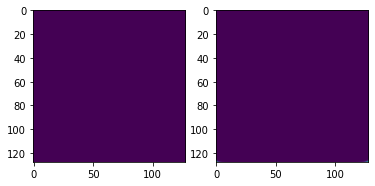

bru:  2.0
8
11
1
4
10
20
16
13
9
0
3
18
7
14
15
21
17
12
19
6
5
2
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
2
4
0
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
3
4
2
0
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 22 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0710 - acc: 0.9627 - val_loss: 0.0775 - val_acc: 0.9623
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0616 - acc: 0.9630 - val_loss: 0.0725 - val_acc: 0.9630
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0589 - acc: 0.9630 - val_loss: 0.0784 - val_acc: 0.9633
Epoch 4/100
22/22 [==============

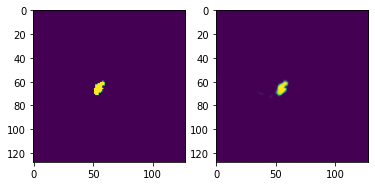

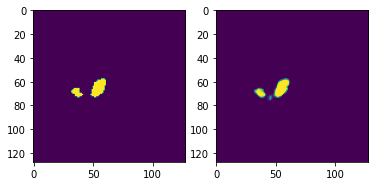

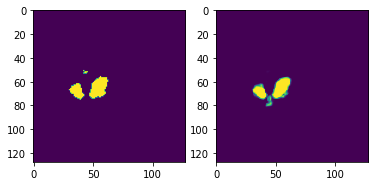

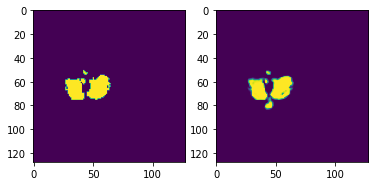

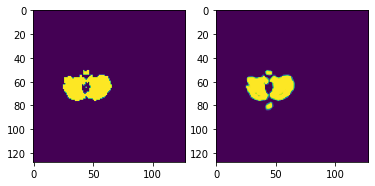

...

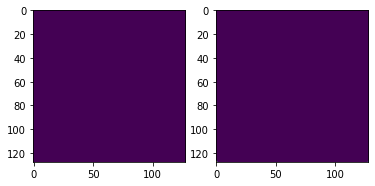

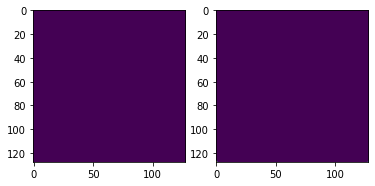

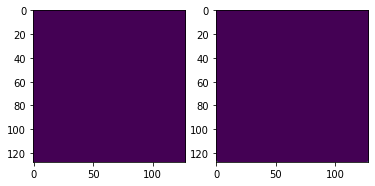

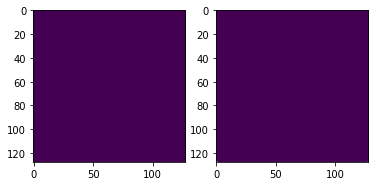

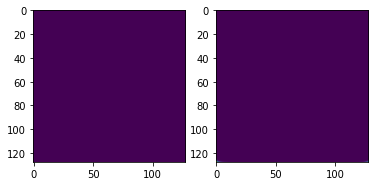

bru:  2.0
13
12
7
5
3
9
4
20
2
16
15
21
17
6
10
1
8
11
19
0
14
18
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
4
3
0
2
1
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
3
2
0
1
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 31 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0460 - acc: 0.9634 - val_loss: 0.0635 - val_acc: 0.9646
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0465 - acc: 0.9633 - val_loss: 0.0556 - val_acc: 0.9642
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0461 - acc: 0.9632 - val_loss: 0.0807 - val_acc: 0.9649
Epoch 4/100
22/22 [============

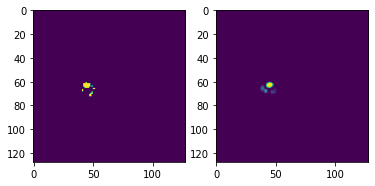

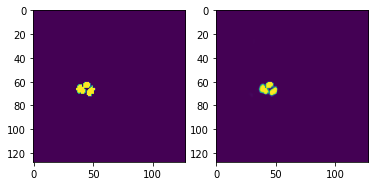

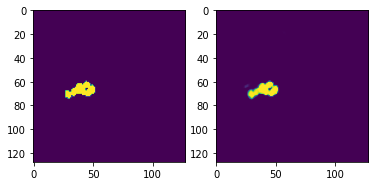

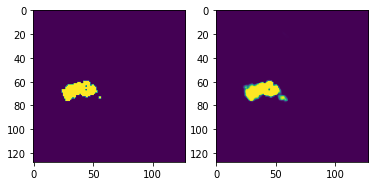

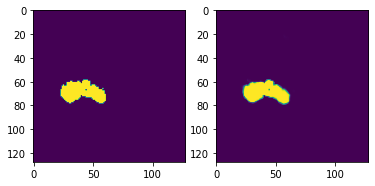

...

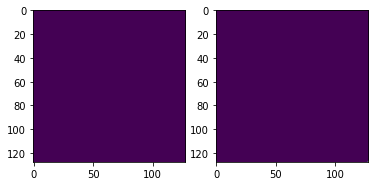

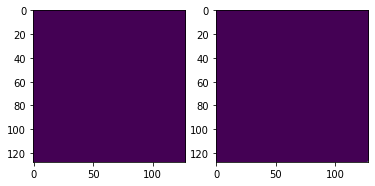

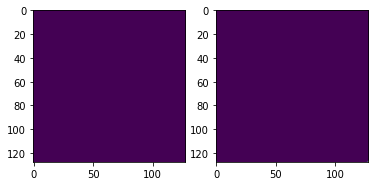

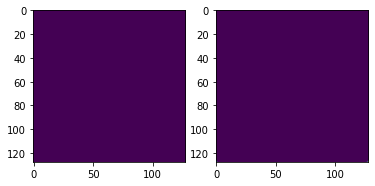

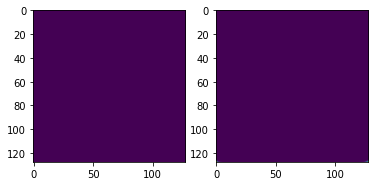

bru:  2.0
4
17
21
12
8
20
13
16
6
18
7
19
15
0
5
3
14
10
1
11
2
9
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
3
1
2
0
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
4
3
0
2
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 32 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0556 - acc: 0.9633 - val_loss: 0.0592 - val_acc: 0.9633
Epoch 2/100
22/22 [==============================] - 20s 886ms/step - loss: 0.0596 - acc: 0.9631 - val_loss: 0.0896 - val_acc: 0.9628
Epoch 3/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0522 - acc: 0.9634 - val_loss: 0.0621 - val_acc: 0.9627
Epoch 4/100
22/22 [==============

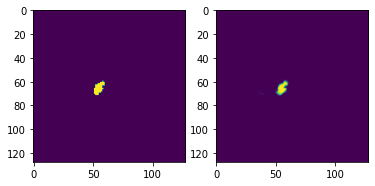

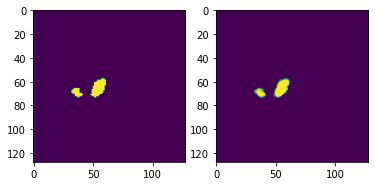

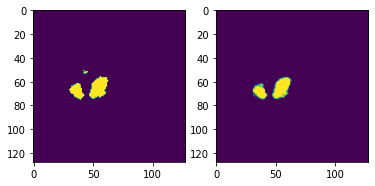

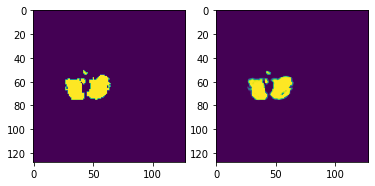

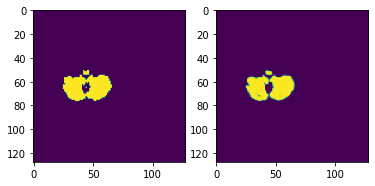

...

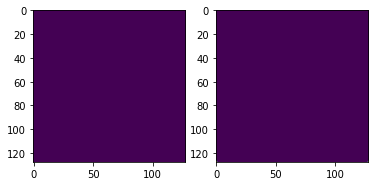

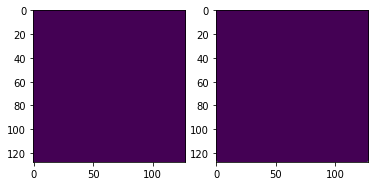

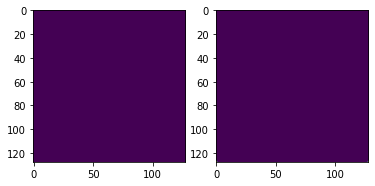

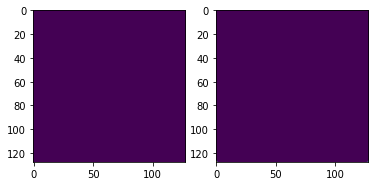

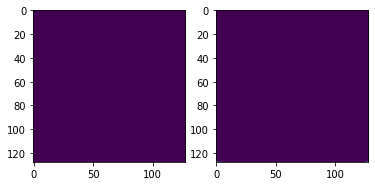

bru:  2.0
6
19
10
9
3
21
2
11
0
4
15
7
14
20
5
17
8
18
12
1
13
16
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
0
2
4
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
0
3
1
4
2
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 41 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0383 - acc: 0.9636 - val_loss: 0.0472 - val_acc: 0.9640
Epoch 2/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0341 - acc: 0.9638 - val_loss: 0.0459 - val_acc: 0.9637
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0371 - acc: 0.9636 - val_loss: 0.0613 - val_acc: 0.9643
Epoch 4/100
22/22 [============

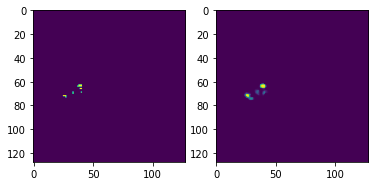

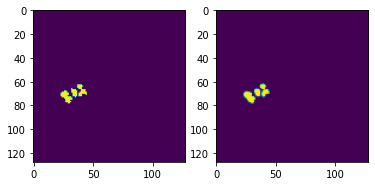

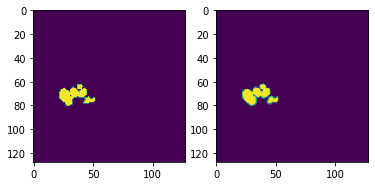

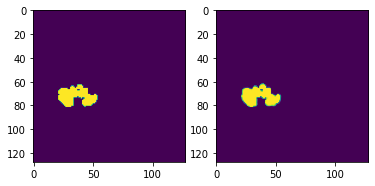

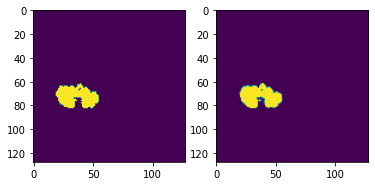

...

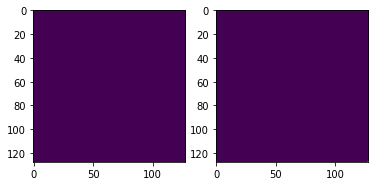

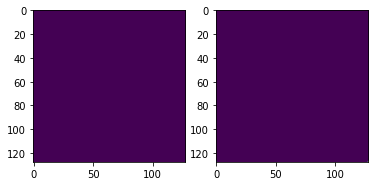

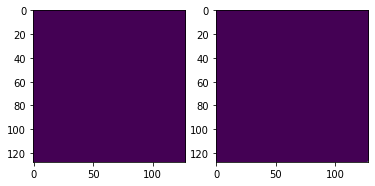

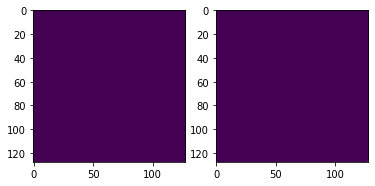

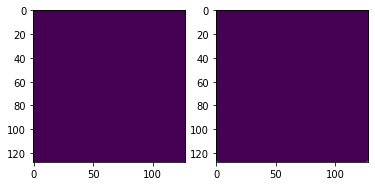

bru:  2.0
21
17
20
12
15
11
4
10
19
8
16
13
9
2
7
0
14
6
5
18
3
1
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
3
2
0
1
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
0
2
3
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 42 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0435 - acc: 0.9637 - val_loss: 0.0765 - val_acc: 0.9634
Epoch 2/100
22/22 [==============================] - 20s 886ms/step - loss: 0.0411 - acc: 0.9638 - val_loss: 0.0744 - val_acc: 0.9637
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0379 - acc: 0.9639 - val_loss: 0.0600 - val_acc: 0.9636
Epoch 4/100
22/22 [==============

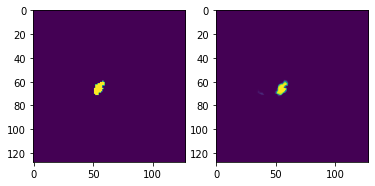

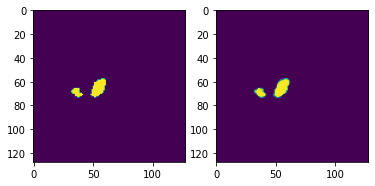

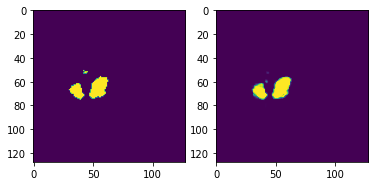

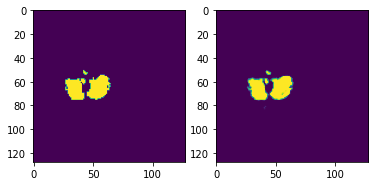

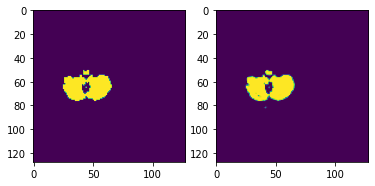

...

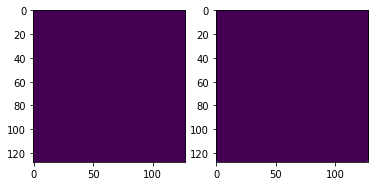

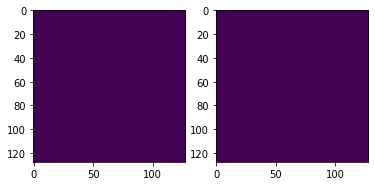

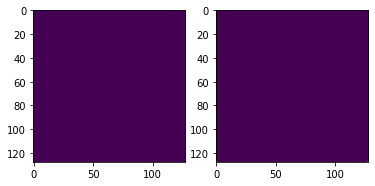

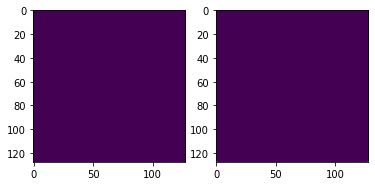

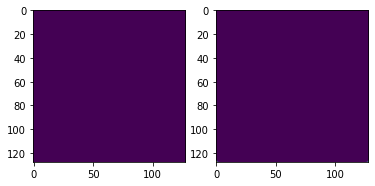

bru:  2.0
21
17
5
15
4
10
2
8
6
18
14
20
13
3
16
11
0
9
7
12
1
19
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
3
4
0
2
1
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
4
1
0
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 51 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0322 - acc: 0.9638 - val_loss: 0.0705 - val_acc: 0.9643
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0302 - acc: 0.9640 - val_loss: 0.0755 - val_acc: 0.9650
Epoch 3/100
22/22 [==============================] - 20s 886ms/step - loss: 0.0285 - acc: 0.9641 - val_loss: 0.0524 - val_acc: 0.9645
Epoch 4/100
22/22 [============

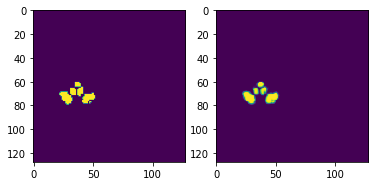

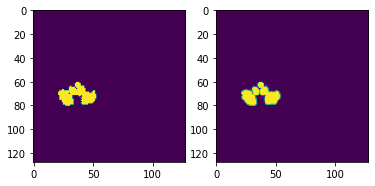

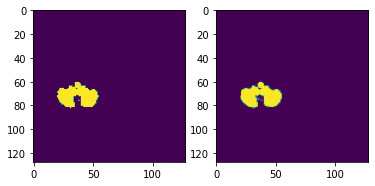

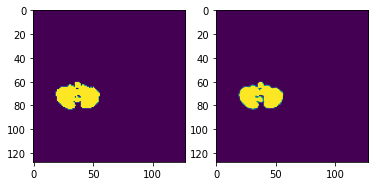

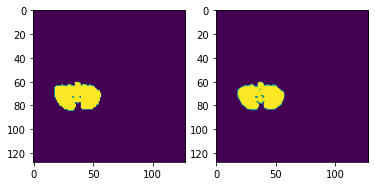

...

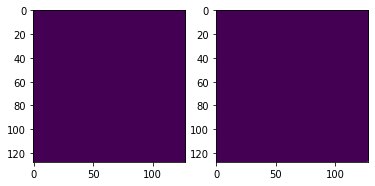

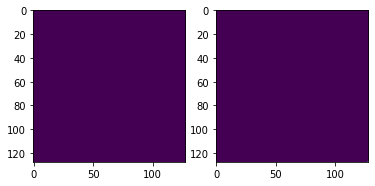

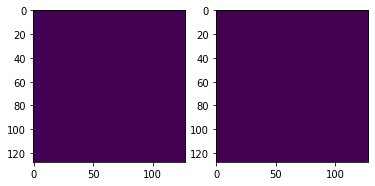

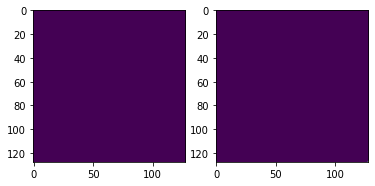

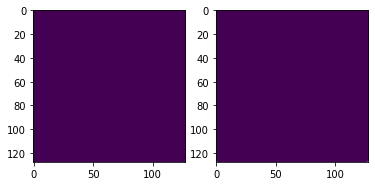

bru:  2.0
4
11
15
17
21
8
10
20
7
18
1
19
16
12
3
6
5
0
2
13
14
9
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
0
2
3
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
0
4
1
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 52 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0437 - acc: 0.9639 - val_loss: 0.0838 - val_acc: 0.9640
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0439 - acc: 0.9630 - val_loss: 0.1249 - val_acc: 0.9642
Epoch 3/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0521 - acc: 0.9627 - val_loss: 0.0678 - val_acc: 0.9637
Epoch 4/100
22/22 [==============

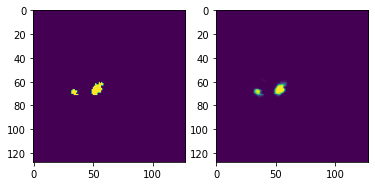

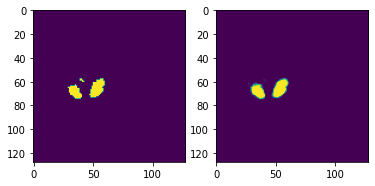

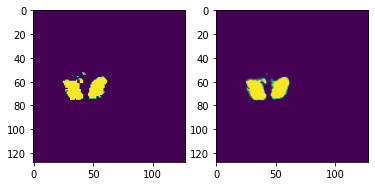

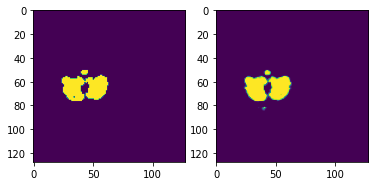

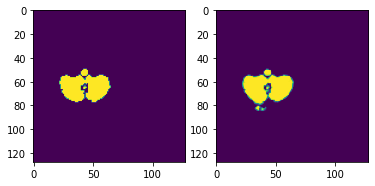

...

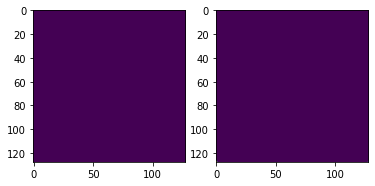

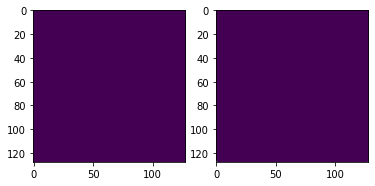

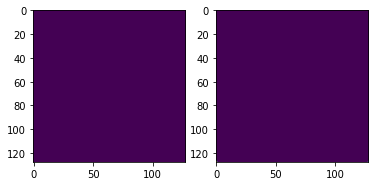

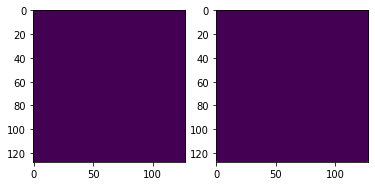

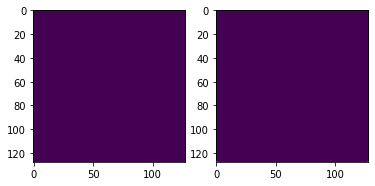

bru:  2.0
21
3
4
9
8
10
0
15
14
7
19
20
12
2
16
11
5
18
13
1
6
17
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
0
1
4
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
4
2
0
3
1
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 61 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0315 - acc: 0.9639 - val_loss: 0.0972 - val_acc: 0.9650
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0296 - acc: 0.9640 - val_loss: 0.0579 - val_acc: 0.9645
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0298 - acc: 0.9640 - val_loss: 0.0488 - val_acc: 0.9643
Epoch 4/100
22/22 [============

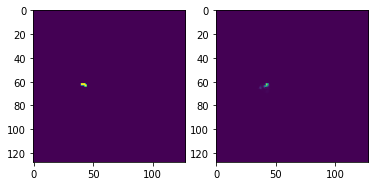

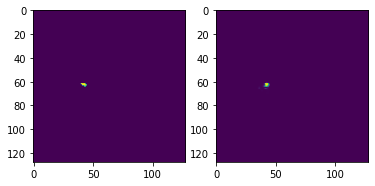

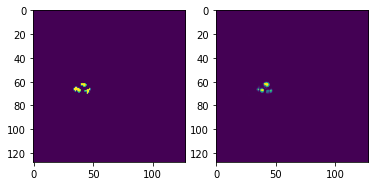

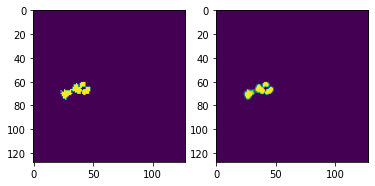

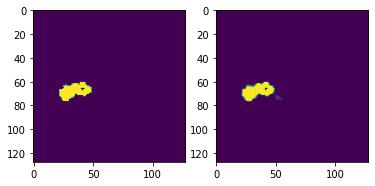

...

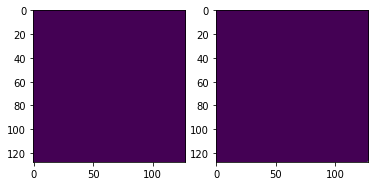

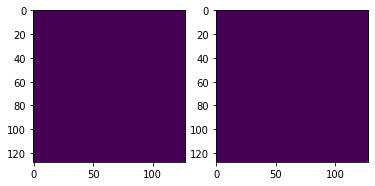

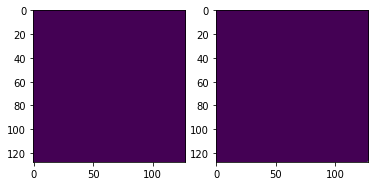

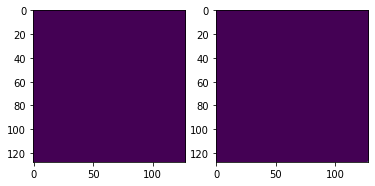

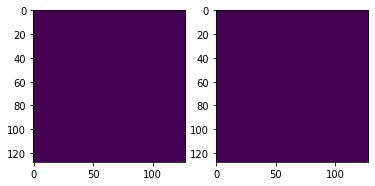

bru:  2.0
12
11
20
10
3
21
17
16
2
14
5
8
9
6
0
4
18
1
13
19
15
7
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
2
4
3
0
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
4
0
3
2
1
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 62 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0364 - acc: 0.9640 - val_loss: 0.0673 - val_acc: 0.9638
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0320 - acc: 0.9641 - val_loss: 0.0980 - val_acc: 0.9643
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0329 - acc: 0.9641 - val_loss: 0.0597 - val_acc: 0.9630
Epoch 4/100
22/22 [==============

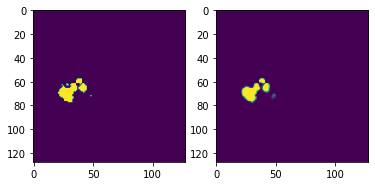

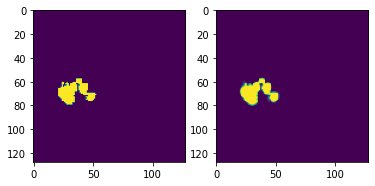

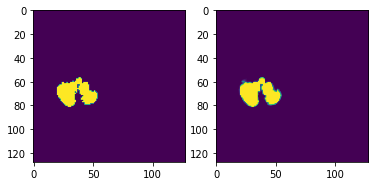

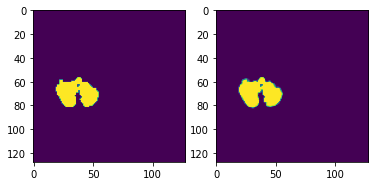

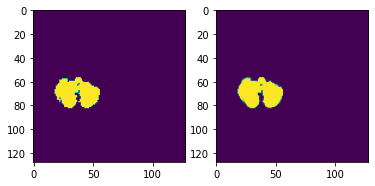

...

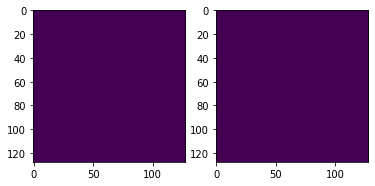

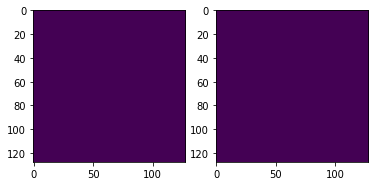

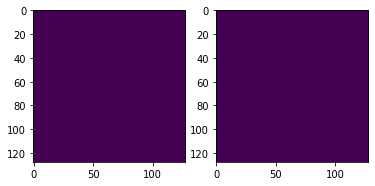

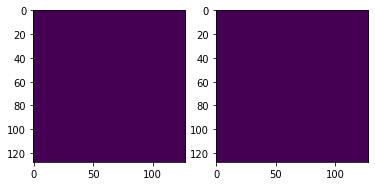

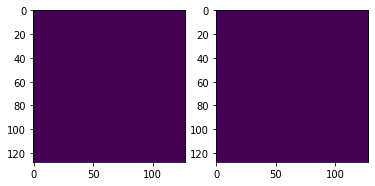

bru:  2.0
16
17
11
8
7
3
20
12
9
6
13
10
14
2
4
18
5
0
19
1
21
15
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
3
2
4
1
0
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
0
4
3
1
2
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 71 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0273 - acc: 0.9641 - val_loss: 0.0495 - val_acc: 0.9639
Epoch 2/100
22/22 [==============================] - 20s 886ms/step - loss: 0.0289 - acc: 0.9640 - val_loss: 0.0574 - val_acc: 0.9642
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0268 - acc: 0.9642 - val_loss: 0.0502 - val_acc: 0.9643
Epoch 4/100
22/22 [============

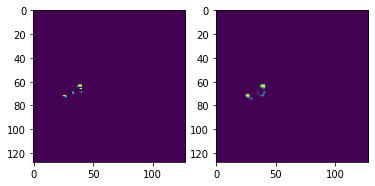

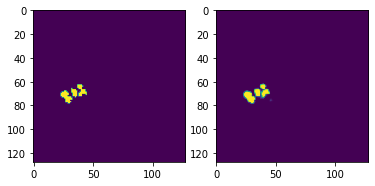

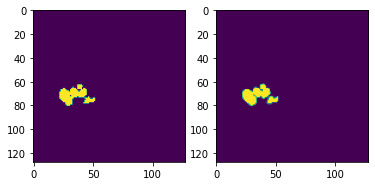

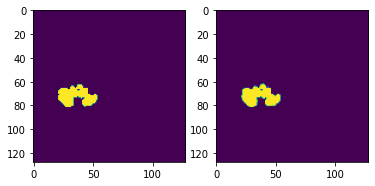

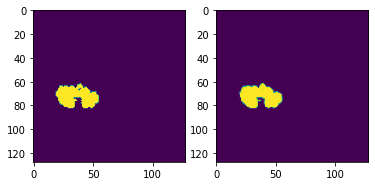

...

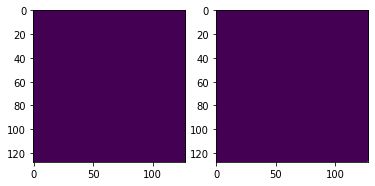

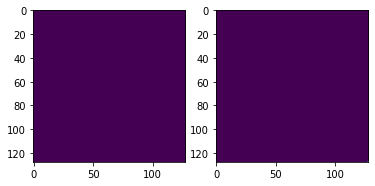

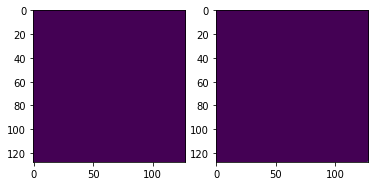

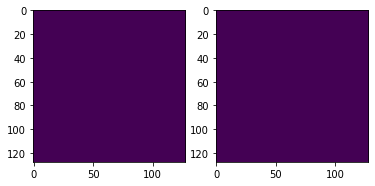

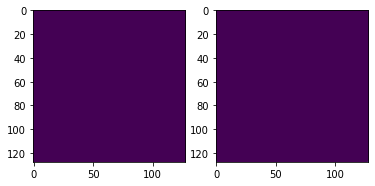

bru:  2.0
3
21
16
7
9
20
5
11
19
14
1
0
17
13
10
18
6
4
2
8
15
12
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
0
3
1
4
2
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
0
1
2
4
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 72 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0278 - acc: 0.9644 - val_loss: 0.0735 - val_acc: 0.9639
Epoch 2/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0250 - acc: 0.9644 - val_loss: 0.0785 - val_acc: 0.9640
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0242 - acc: 0.9645 - val_loss: 0.0735 - val_acc: 0.9636
Epoch 4/100
22/22 [==============

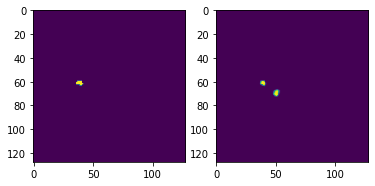

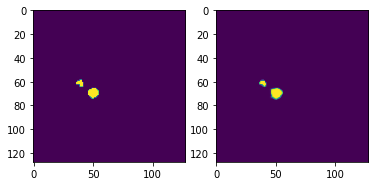

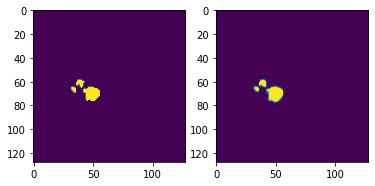

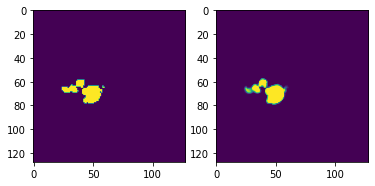

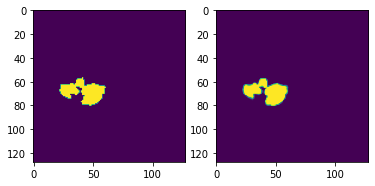

...

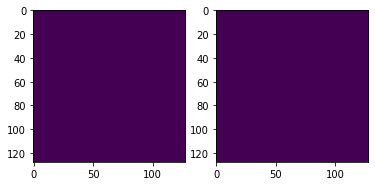

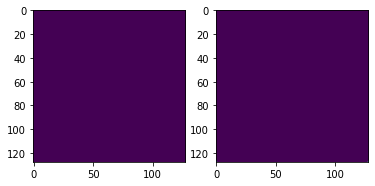

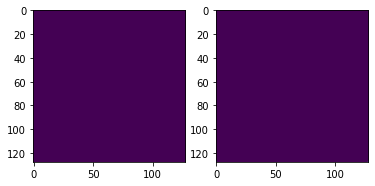

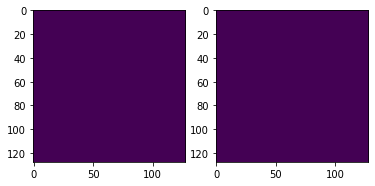

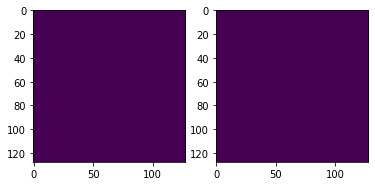

bru:  2.0
14
15
11
4
21
3
10
7
17
6
19
20
2
1
5
0
16
9
12
18
13
8
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
0
1
3
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
0
2
3
4
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 81 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0284 - acc: 0.9640 - val_loss: 0.0773 - val_acc: 0.9649
Epoch 2/100
22/22 [==============================] - 19s 885ms/step - loss: 0.0292 - acc: 0.9640 - val_loss: 0.0647 - val_acc: 0.9648
Epoch 3/100
22/22 [==============================] - 19s 885ms/step - loss: 0.0245 - acc: 0.9642 - val_loss: 0.0791 - val_acc: 0.9646
Epoch 4/100
22/22 [============

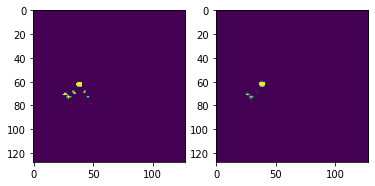

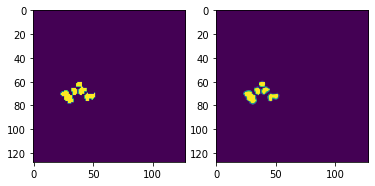

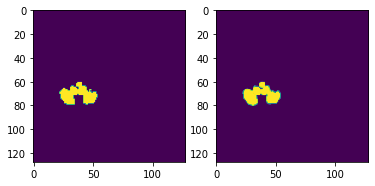

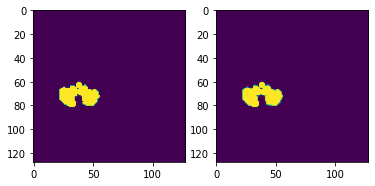

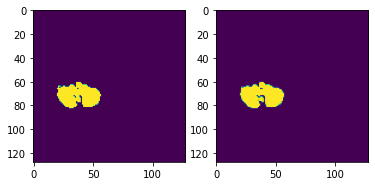

...

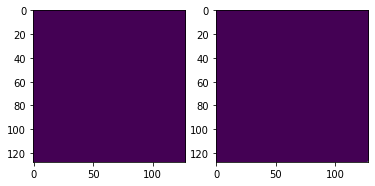

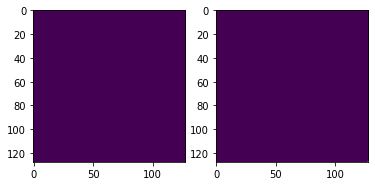

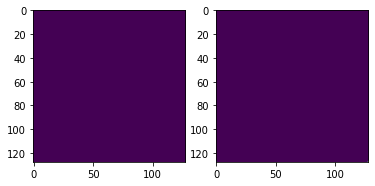

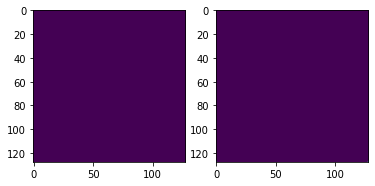

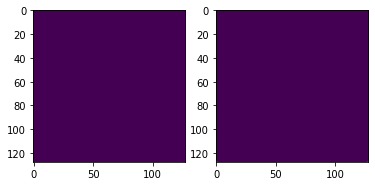

bru:  2.0
13
18
0
8
15
9
4
20
1
5
7
21
14
12
17
11
16
2
10
6
19
3
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
3
4
0
2
1
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
2
0
1
4
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 82 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 888ms/step - loss: 0.0254 - acc: 0.9644 - val_loss: 0.0844 - val_acc: 0.9640
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0235 - acc: 0.9646 - val_loss: 0.0951 - val_acc: 0.9642
Epoch 3/100
22/22 [==============================] - 19s 885ms/step - loss: 0.0218 - acc: 0.9646 - val_loss: 0.0965 - val_acc: 0.9642
Epoch 4/100
22/22 [==============

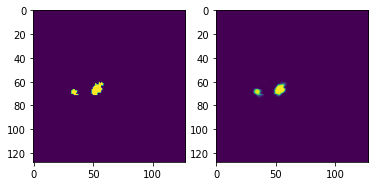

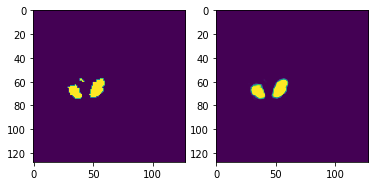

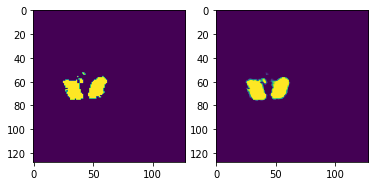

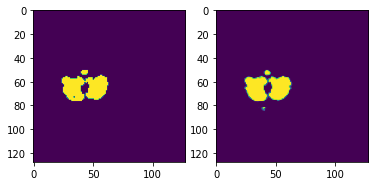

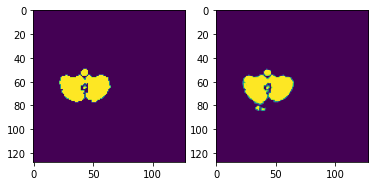

...

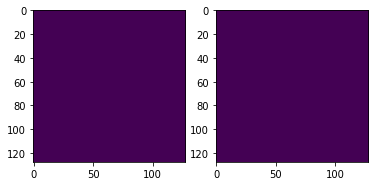

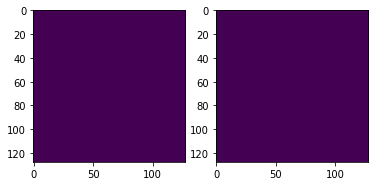

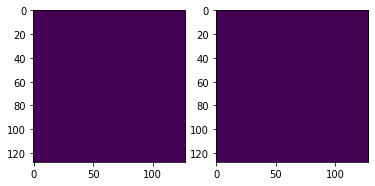

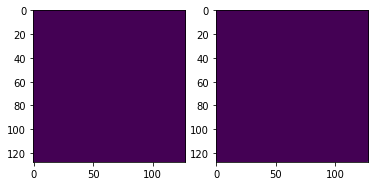

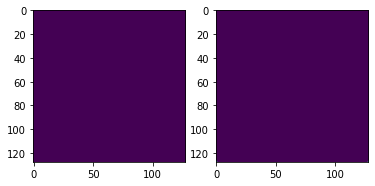

bru:  2.0
0
1
8
11
20
4
12
14
9
10
19
13
3
2
6
5
16
21
7
15
18
17
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
2
0
4
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
4
0
3
1
2
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 91 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0242 - acc: 0.9642 - val_loss: 0.0712 - val_acc: 0.9646
Epoch 2/100
22/22 [==============================] - 19s 885ms/step - loss: 0.0242 - acc: 0.9642 - val_loss: 0.0625 - val_acc: 0.9648
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0234 - acc: 0.9643 - val_loss: 0.0641 - val_acc: 0.9649
Epoch 4/100
22/22 [============

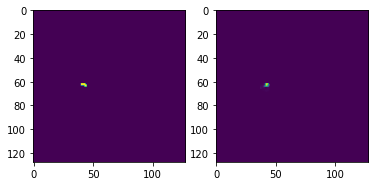

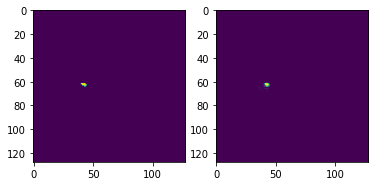

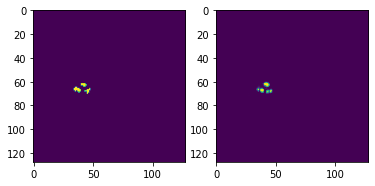

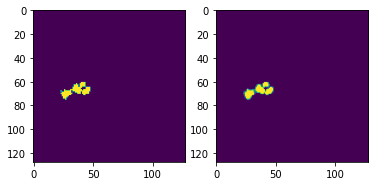

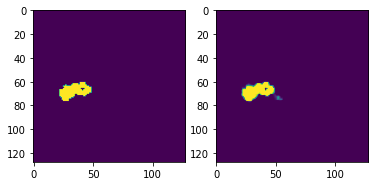

...

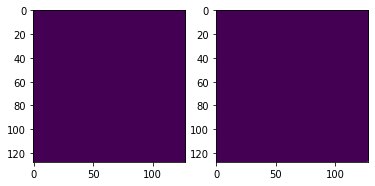

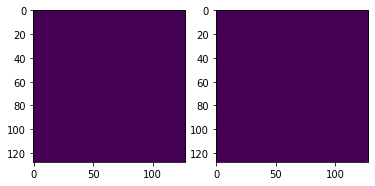

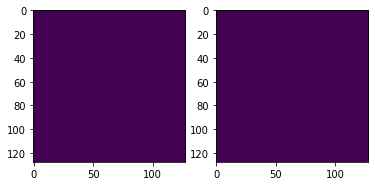

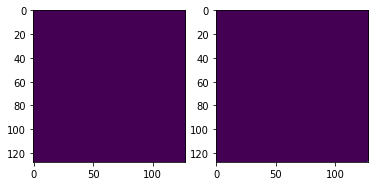

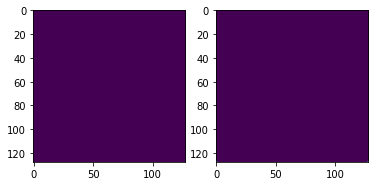

bru:  2.0
16
2
20
11
19
6
4
12
9
5
18
14
10
0
17
15
21
13
8
1
3
7
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8742350466857354 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
3
4
2
1
0
images shape: (5, 128, 128, 128, 1)
images max and min: 0.94812461660372 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
4
0
3
1
2
images shape: (5, 128, 128, 128, 1)
images max and min: 0.9287703724331436 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 92 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0241 - acc: 0.9645 - val_loss: 0.0795 - val_acc: 0.9640
Epoch 2/100
22/22 [==============================] - 19s 885ms/step - loss: 0.0217 - acc: 0.9646 - val_loss: 0.0881 - val_acc: 0.9641
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0203 - acc: 0.9646 - val_loss: 0.0843 - val_acc: 0.9641
Epoch 4/100
22/22 [==============

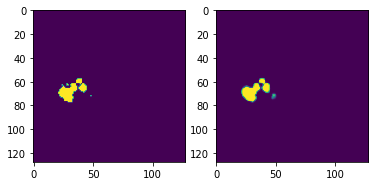

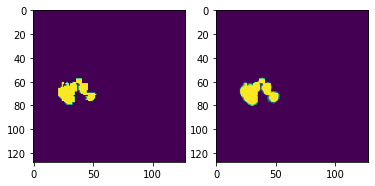

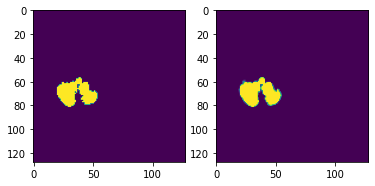

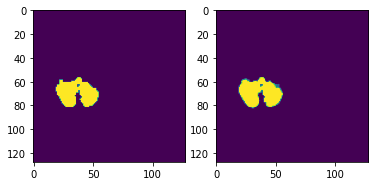

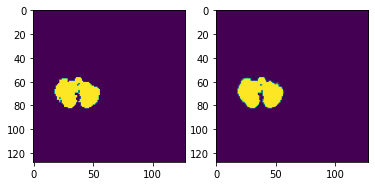

...

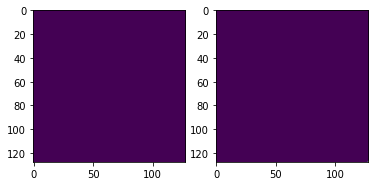

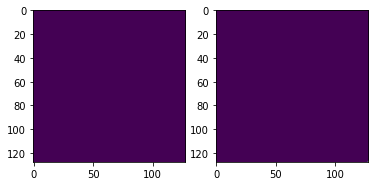

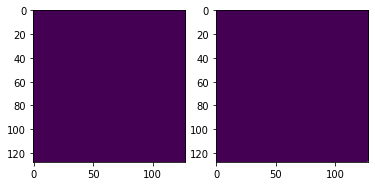

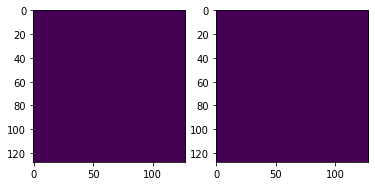

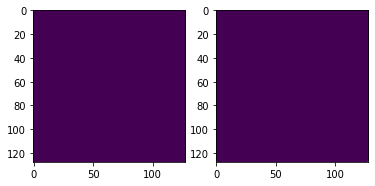

bru:  2.0
16
17
3
7
21
14
4
18
6
12
19
10
2
9
5
1
8
20
11
13
0
15
images shape: (22, 128, 128, 128, 1)
images max and min: 0.8672312564192275 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
4
2
0
3
images shape: (5, 128, 128, 128, 1)
images max and min: 0.8264716660546286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
bru:  2.0
1
4
3
0
2
images shape: (5, 128, 128, 128, 1)
images max and min: 0.7249104007006286 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 101 out of 1000 sets...
Epoch 1/100
22/22 [==============================] - 20s 887ms/step - loss: 0.0252 - acc: 0.9642 - val_loss: 0.0921 - val_acc: 0.9648
Epoch 2/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0236 - acc: 0.9642 - val_loss: 0.0713 - val_acc: 0.9649
Epoch 3/100
22/22 [==============================] - 19s 886ms/step - loss: 0.0216 - acc: 0.9643 - val_loss: 0.0969 - val_acc: 0.9653
Epoch 4/100
22/22 [===========

In [ ]:
image_size = 128

import time
start_time = time.time()



epochs = 100
ep = 1000
batch_size = 1
num_batches = 2


model_name = "Brain Seg t1 12 rough"


model = ConvNet(image_size,image_size,image_size)
model.compile(optimizer = keras.optimizers.Adam(lr=0.0001), loss=weighted_bce, metrics=["acc"])

def get_data(n):
    train_images_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Train Images " + str(n) + ".h5"
    train_masks_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Train Masks " + str(n) + ".h5"
    val_images_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Val Images " + str(n) + ".h5"
    val_masks_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Val Masks " + str(n) + ".h5"
    test_images_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Test Images " + str(n) + ".h5"
    test_masks_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Test Masks " + str(n) + ".h5"

    if not os.path.exists("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/" + model_name):
        os.mkdir("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/" + model_name)

    train_gen = DataGen(train_images_path, train_masks_path, batch_size=batch_size, image_size=image_size)
    valid_gen = DataGen(val_images_path, val_masks_path, batch_size=batch_size, image_size=image_size)
    test_gen = DataGen(test_images_path, test_masks_path, batch_size=batch_size, image_size=image_size)
    return train_gen,valid_gen,test_gen

def train(train_gen, valid_gen, test_gen, model_number):
    print("Training set " + str(i+1) + str(n+1)+" out of " + str(ep) + " sets...")

    train_steps = train_gen.data_size//batch_size
    valid_steps = valid_gen.data_size//batch_size

    model.fit_generator(train_gen, validation_data=valid_gen, steps_per_epoch=train_steps, validation_steps=valid_steps, epochs=epochs, shuffle=True)

    ## Save the Weights

    model.save("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/" + model_name + "/Model " + model_number +".h5")

    print('trainted one model in', int((time.time() - start_time)/60), 'minutes and ', int((time.time() - start_time) % 60), 'seconds.')
'''
print("0")
train_gen0,valid_gen0,test_gen0 = get_data(0)
train_gen1,valid_gen1,test_gen1 = get_data(1)
print("2")
train_gen2,valid_gen2,test_gen2 = get_data(2)
train_gen3,valid_gen3,test_gen3 = get_data(3)
print("4")
train_gen4,valid_gen4,test_gen4 = get_data(4)
train_gen5,valid_gen5,test_gen5 = get_data(5)
print("6")
train_gen6,valid_gen6,test_gen6 = get_data(6)
train_gen7,valid_gen7,test_gen7 = get_data(7)
print("8")
train_gen8,valid_gen8,test_gen8 = get_data(8)
train_gen9,valid_gen9,test_gen9 = get_data(9)
print("10")
'''

last_images = 0
for i in range(0,ep):
    for n in range(0, num_batches):
        train_gen,valid_gen,test_gen = get_data(n)
        train(train_gen,valid_gen,test_gen, (str(i+1)+str(n+1)))


        ## Dataset for prediction
        if True:#(((i*10)+n)*epochs)/40>last_images:
            last_images += 1
            x, y = test_gen.__getitem__(0)

            print(y.shape)
            print("max:",np.max(y))
            result = model.predict(x)
            print(result.shape)
            print("max:",np.max(result))

            #result = result > 0.5

            r = random.randint(0, len(y)-1)
            gt = np.argmax(y[r], axis=3)
            print(gt.shape)
            print("gt unique:",np.unique(gt))
            pred = np.argmax(result[r], axis=3)
            print(pred.shape)
            print("pred unique:",np.unique(pred))
            for n, image in enumerate(np.squeeze(y[r], axis=3)):
                fig = plt.figure()
                #fig.subplots_adjust(hspace=0.4, wspace=0.4)
                ax = fig.add_subplot(1, 2, 1)
                ax.imshow(image==1)
                ax = fig.add_subplot(1, 2, 2)
                ax.imshow(np.squeeze(result[r][n], axis = 2))


                plt.show()
                    
            

(1, 128, 128, 128, 1)
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
(1, 128, 128, 128, 1)
max: 1.0
max:  0.2751673
(1, 128, 128, 128, 1)
max: 0.2751673


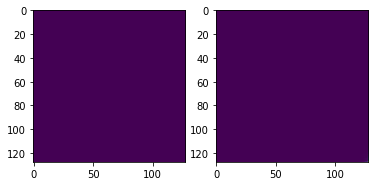

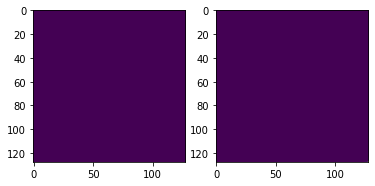

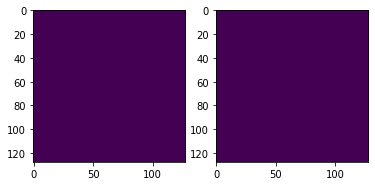

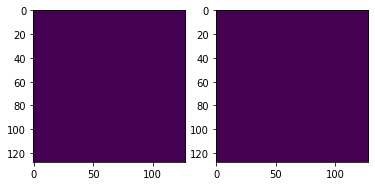

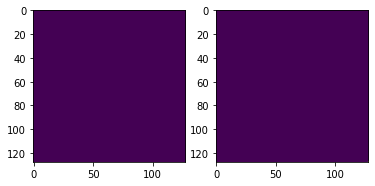

...

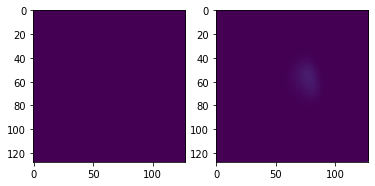

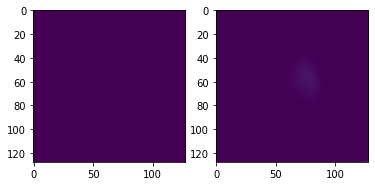

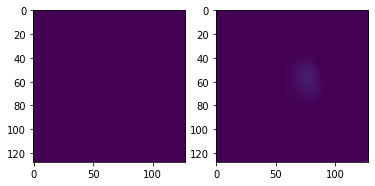

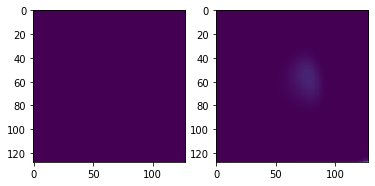

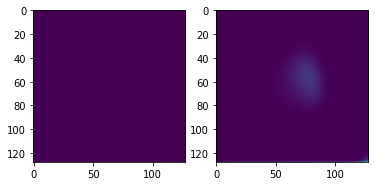

In [ ]:
test_images_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Separated into 64 datapoint batches for Brain Seg/Test Images 0.h5"
test_masks_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Separated into 64 datapoint batches for Brain Seg/Test Masks 0.h5"

batch_size = 1
image_size = 128

test_gen = DataGen(test_images_path, test_masks_path, batch_size=batch_size, image_size=image_size)

x, y = test_gen.get_array(4)
print(x.shape)



#model = keras.models.load_model("/content/drive/My Drive/Tumor Segmentation Project/Trained Models/Segmented Brain -> Segmented Tumor/Model 1 (Tumor Seg Model 2) precise but only center")
#model = keras.models.load_model("/content/drive/My Drive/Tumor Segmentation Project/Trained Models/Segmented Brain -> Segmented Tumor/Model 2 (Tumor Seg 7) Trained with model 1 and higlights entire but not precise")

model = keras.models.load_model("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/Brain Seg Model 8/Model 34")

asdf = x.copy()
print(y.shape)
print("max:",np.max(y))
result = model.predict(x)
print("max: ", np.max(result))
print(result.shape)
print("max:",np.max(result))
x[result < 0.5*(np.max(result))] = 0
asdf[y == 0] = 0

r = 0

for n, image_ in enumerate(y[r]):
    fig = plt.figure()
    #fig.subplots_adjust(hspace=0.4, wspace=0.4)
    ax = fig.add_subplot(1, 2, 1)
    ax.imshow(np.squeeze(y[r][n], axis = 2))
    ax = fig.add_subplot(1, 2, 2)
    ax.imshow(np.squeeze(result[r][n], axis = 2))


    plt.show()

n: 1
17
15
6
3
14
2
13
10
0
20
1
18
21
19
12
7
11
4
8
9
5
16
images shape: (22, 128, 128, 128, 1)
images max and min: 1.5374001809274738 0.0
masks shape: (22, 128, 128, 128, 1)
masks max and min: 2.0 0.0
3
0
1
4
2
images shape: (5, 128, 128, 128, 1)
images max and min: 1.4425097647014542 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
0
4
2
1
3
images shape: (5, 128, 128, 128, 1)
images max and min: 1.1190924749153972 0.0
masks shape: (5, 128, 128, 128, 1)
masks max and min: 2.0 0.0
Training set 12 out of 1000 sets...
Epoch 1/100
zero weight: Tensor("weighted_bce/truediv_1:0", shape=(), dtype=float32)
ones weight: Tensor("weighted_bce/truediv_3:0", shape=(), dtype=float32)
twos weight: Tensor("weighted_bce/truediv_5:0", shape=(), dtype=float32)
zero weight: Tensor("weighted_bce/truediv_1:0", shape=(), dtype=float32)
ones weight: Tensor("weighted_bce/truediv_3:0", shape=(), dtype=float32)
twos weight: Tensor("weighted_bce/truediv_5:0", shape=(), dtype=float32)
11/11 [=

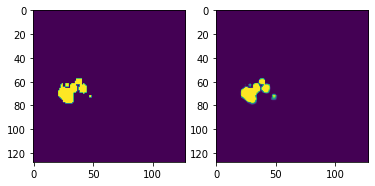

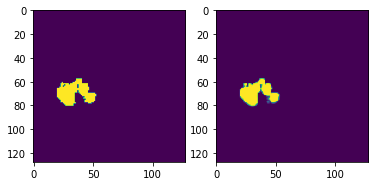

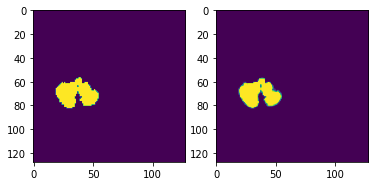

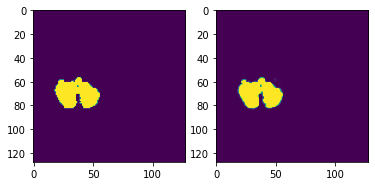

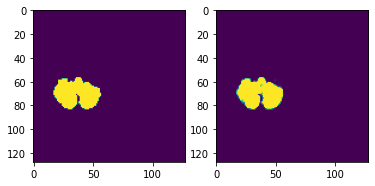

...

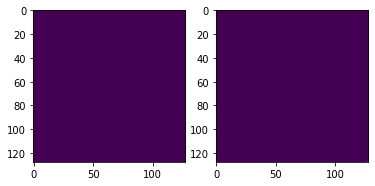

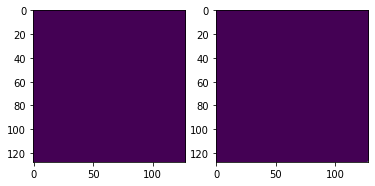

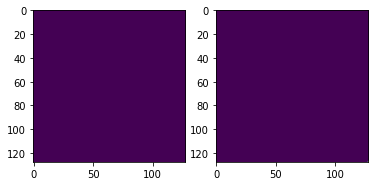

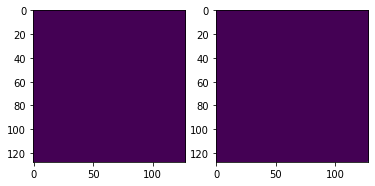

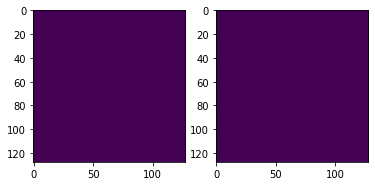

n: 0
20
19
21
12
17
1
7
5
15
0
14
4
16
18
9
8
13
2
3
10
6
11


In [ ]:
model = keras.models.load_model("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/Brain Seg t1 12 rough/Model 21.h5", compile=False)
model.compile(optimizer = keras.optimizers.Adam(lr=0.00001), loss=weighted_bce, metrics=["acc"])

image_size = 128

import time
start_time = time.time()



epochs = 100
ep = 1000
batch_size = 2
num_batches = 2

start_batch = 1

model_name = "Brain Seg t1 13 rough"



def get_data(n):
    train_images_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Train Images " + str(n) + ".h5"
    train_masks_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Train Masks " + str(n) + ".h5"
    val_images_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Val Images " + str(n) + ".h5"
    val_masks_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Val Masks " + str(n) + ".h5"
    test_images_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Test Images " + str(n) + ".h5"
    test_masks_path = "/content/drive/My Drive/Tumor Segmentation Project/Data/Seperate into 64 datapoint batches for Brain Seg OASIS/Test Masks " + str(n) + ".h5"

    if not os.path.exists("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/" + model_name):
        os.mkdir("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/" + model_name)

    train_gen = DataGen(train_images_path, train_masks_path, batch_size=batch_size, image_size=image_size)
    valid_gen = DataGen(val_images_path, val_masks_path, batch_size=batch_size, image_size=image_size)
    test_gen = DataGen(test_images_path, test_masks_path, batch_size=batch_size, image_size=image_size)
    return train_gen,valid_gen,test_gen

def train(train_gen, valid_gen, test_gen, model_number):
    print("Training set " + str(i+1) + str(n+1)+" out of " + str(ep) + " sets...")

    train_steps = train_gen.data_size//batch_size
    valid_steps = valid_gen.data_size//batch_size

    model.fit_generator(train_gen, validation_data=valid_gen, steps_per_epoch=train_steps, validation_steps=valid_steps, epochs=epochs, shuffle=True)

    ## Save the Weights

    model.save("/content/drive/My Drive/Tumor Segmentation Project/Saved Models (Not good models)/" + model_name + "/Model " + model_number +".h5")

    print('trainted one model in', int((time.time() - start_time)/60), 'minutes and ', int((time.time() - start_time) % 60), 'seconds.')


last_images = 0
for i in range(0,ep):
    for n in range(0, num_batches):
        n = (n+start_batch)%num_batches
        print("n:",n)
        train_gen,valid_gen,test_gen = get_data(n)
        train(train_gen,valid_gen,test_gen, (str(i+1)+str(n+1)))


        ## Dataset for prediction
        if True:#(((i*10)+n)*epochs)/40>last_images:
            last_images += 1
            x, y = test_gen.__getitem__(0)

            print(y.shape)
            print("max:",np.max(y))
            result = model.predict(x)
            print(result.shape)
            print("max:",np.max(result))

            #result = result > 0.5

            r = random.randint(0, len(y)-1)
            gt = np.argmax(y[r], axis=3)
            print(gt.shape)
            print("gt unique:",np.unique(gt))
            pred = np.argmax(result[r], axis=3)
            print(pred.shape)
            print("pred unique:",np.unique(pred))
            for n, image in enumerate(np.squeeze(y[r], axis=3)):
                fig = plt.figure()
                #fig.subplots_adjust(hspace=0.4, wspace=0.4)
                ax = fig.add_subplot(1, 2, 1)
                ax.imshow(image==1)
                ax = fig.add_subplot(1, 2, 2)
                ax.imshow(np.squeeze(result[r][n], axis = 2))


                plt.show()
